# Store Sales - Time Series Forecasting
> This is a competition project about time series forecasting on sales.
> 
> There is a total of 5 main datasets to train on; we will take a look into them one by one.\
> 1.train\
> 2.oil\
> 3.holidays events\
> 4.stores\
> 5.transactions

I thought of doing the correlations and looking at interesting insights on how the prediction model should have worked, and what strikes me is whether to use row-based or aggregated numbers. Since we're trying to predict the subsequential date of the train data, I feel like row-based would be a better start, even though it might be harder to analyze than doing aggregation first because it would be , that is the better way to get superior prediction model performance.

## 1. EDA
Our ultimate goal is to **forecast sales using RMSLE** in Ecuador.
Here is a checklist of what we have to do:
- Load the datasets
- Check data types & shapes	
- Look for missing values	
- Check unique values	
- Check date ranges (for time series)
- Merge them for some basic analysis

*Note: Kaggle provides an excellent user interface that can easily check data range, missing value, and even data distribution, but we check them anyway for demonstration purposes.*

In [1]:
# Import neccessary libraries
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import numpy as np
import plotly.express as px # For interactive plots

In [2]:
# Import the datasets
import pandas as pd
train = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/train.csv')
test = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/test.csv')
oil = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/oil.csv')
holidays = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/holidays_events.csv')
stores = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/stores.csv')
transactions = pd.read_csv('/kaggle/input/store-sales-time-series-forecasting/transactions.csv')

In [3]:
# Quick shape check 
print(train.shape)
print(test.shape)
print(stores.shape)  
print(oil.shape)
print(holidays.shape)
print(transactions.shape)

(3000888, 6)
(28512, 5)
(54, 5)
(1218, 2)
(350, 6)
(83488, 3)


In [4]:
# Check date type
print("Train Data Types:")
print(train.dtypes)

print("\n Test Data Types:")
print(test.dtypes)

print("\n Stores Data Types:")
print(stores.dtypes)

print("\n Oil Data Types:")
print(oil.dtypes)

print("\n Holidays Data Types:")
print(holidays.dtypes)

print("\n Transactions Data Types:")
print(transactions.dtypes)

Train Data Types:
id               int64
date            object
store_nbr        int64
family          object
sales          float64
onpromotion      int64
dtype: object

 Test Data Types:
id              int64
date           object
store_nbr       int64
family         object
onpromotion     int64
dtype: object

 Stores Data Types:
store_nbr     int64
city         object
state        object
type         object
cluster       int64
dtype: object

 Oil Data Types:
date           object
dcoilwtico    float64
dtype: object

 Holidays Data Types:
date           object
type           object
locale         object
locale_name    object
description    object
transferred      bool
dtype: object

 Transactions Data Types:
date            object
store_nbr        int64
transactions     int64
dtype: object


In [5]:
# Change [string to datetime] to avoid error
train['date'] = pd.to_datetime(train['date'])
oil['date'] = pd.to_datetime(oil['date'])
holidays['date'] = pd.to_datetime(holidays['date'])
test['date'] = pd.to_datetime(test['date'])
transactions['date']= pd.to_datetime(transactions['date'])

In [6]:
# Downgrade [data type] on dataset to save memory usage 
# (only when you know the data range and have a static dataset)

# Train
train['id'] = train['id'].astype('int32')
train['store_nbr'] = train['store_nbr'].astype('int8')
train['sales'] = train['sales'].astype('float32')  
train['onpromotion'] = train['onpromotion'].astype('int16')

# Test
test['id'] = test['id'].astype('int32')
test['store_nbr'] = test['store_nbr'].astype('int8')
test['onpromotion'] = test['onpromotion'].astype('int16')

# Oil
oil['dcoilwtico'] = oil['dcoilwtico'].astype('float16')  # Use float32 if values are large decimals

# Stores
stores['store_nbr'] = stores['store_nbr'].astype('int8')
stores['cluster'] = stores['cluster'].astype('int8')

# Transactions
transactions['store_nbr'] = transactions['store_nbr'].astype('int8')
transactions['transactions'] = transactions['transactions'].astype('int16')

## 1-1. Train 
This is where we do the **core prediction** for the unit sales.\
Every record is the total sales for a specific product family at a specific store on a specific date.
- `date`: The date of the sales record. Used to extract time-based features like day-of-week, month, holidays, etc.
- `store_nbr`: Store identifier (1–54). Each store has a unique type and cluster.
- `family`: Product family/category (e.g., DAIRY, BEVERAGES). Each store carries multiple families.
- `onpromotion`: Number of items in this family that were promoted on that date. Higher values may correlate with higher sales.
- `sales`: The number of units sold. This is the prediction target. Some products are sold in fractional units (e.g., 0.75 kg).

In [7]:
train.head(10)

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0
5,5,2013-01-01,1,BREAD/BAKERY,0.0,0
6,6,2013-01-01,1,CELEBRATION,0.0,0
7,7,2013-01-01,1,CLEANING,0.0,0
8,8,2013-01-01,1,DAIRY,0.0,0
9,9,2013-01-01,1,DELI,0.0,0


In [8]:
# Total missing values per column
print(" Missing Values in train:")
print(train.isnull().sum())

 Missing Values in train:
id             0
date           0
store_nbr      0
family         0
sales          0
onpromotion    0
dtype: int64


In [9]:
# Check for negative sales 
print("Neg counts (sales):", (train['sales'] < 0).sum()) 
print("Neg counts (onpromotion):", (train['onpromotion'] < 0).sum())  

Neg counts (sales): 0
Neg counts (onpromotion): 0


In [10]:
# Check for duplicates (full identical rows)
print("Duplicate count:",train.duplicated().sum())

Duplicate count: 0


In [11]:
# Full date coverage
print("Timeframe:", train['date'].min(), train['date'].max())

Timeframe: 2013-01-01 00:00:00 2017-08-15 00:00:00


In [12]:
# Unique store and family values
print("Stores:", train['store_nbr'].nunique(), "Categories:", train['family'].nunique())  # Expect 54 stores, 33 categories

Stores: 54 Categories: 33


Correlation between OnPromotion and Sales: 0.4279


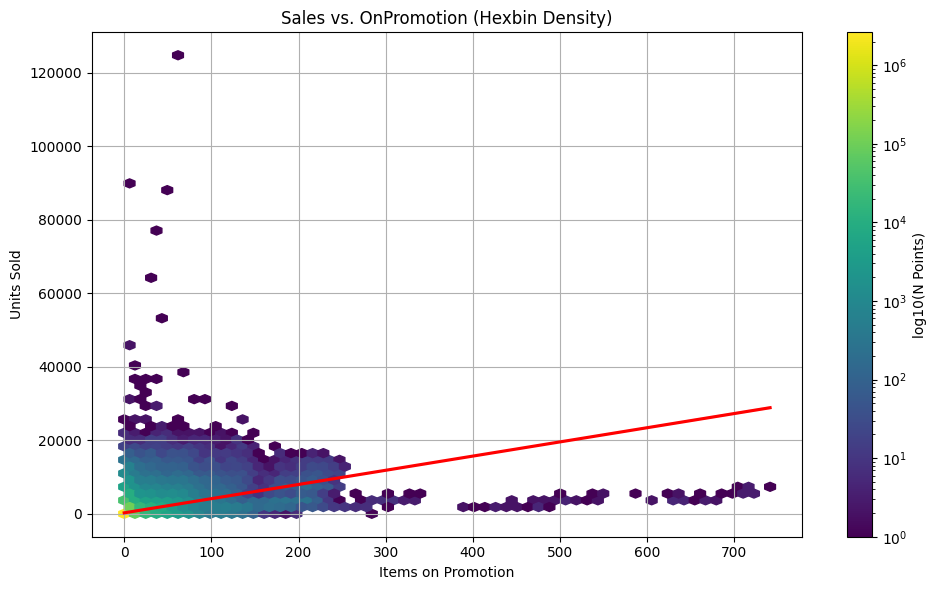

In [13]:
# Pearson correlation
promo_corr = train['onpromotion'].corr(train['sales'])
print(f"Correlation between OnPromotion and Sales: {promo_corr:.4f}")

plt.figure(figsize=(10, 6))

plt.hexbin(
    x=train['onpromotion'],
    y=train['sales'],
    gridsize=60,            # number of hexes across X-axis
    cmap='viridis',
    bins='log'              # log scale for color intensity
)

# Overlay regression line (optional log-scale or linear)
sns.regplot(
    x='onpromotion', 
    y='sales', 
    data=train, 
    scatter=False,  # Don't double-plot
    color='red', 
    line_kws={'label':"Linear Fit"}
)


plt.colorbar(label='log10(N Points)')
plt.title("Sales vs. OnPromotion (Hexbin Density)")
plt.xlabel("Items on Promotion")
plt.ylabel("Units Sold")
plt.grid(True)
plt.tight_layout()
plt.show()

`The Pearson correlation coefficient of 0.4279` and `the hexbin density plot` suggest a **moderately positive** relationship between the number of items on promotion and the number of units sold.
While most sales occur when relatively few items are on promotion (as seen in the dense bottom-left cluster), there's a clear upward pattern indicating that sales tend to increase as promotions rise — though the effect may vary across product families and stores.

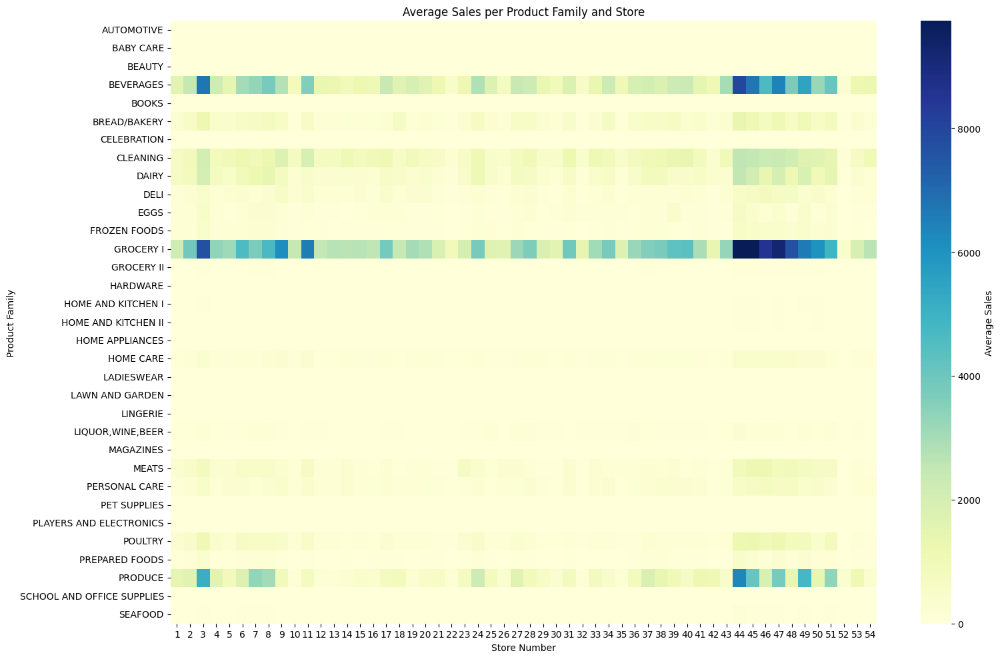

In [14]:
# Check correlation between store and family product

#  the average sales per row for each family at each store
pivot = train.pivot_table(index='family', columns='store_nbr', values='sales', aggfunc='mean', fill_value=0)

plt.figure(figsize=(16, 10))
sns.heatmap(pivot, cmap='YlGnBu', cbar_kws={'label': 'Average Sales'})
plt.title("Average Sales per Product Family and Store")
plt.xlabel("Store Number")
plt.ylabel("Product Family")
plt.tight_layout()
plt.show()

1. GROCERY I, BEVERAGES, and PRODUCE stand out-> possibly bulk sale
2. Most families are light-colored-> low demand

Feature engineering!!!

## 1-2. Oil
Oil Prices Dataset This dataset contains the `daily oil price (dcoilwtico)` in Ecuador from 2013 to 2017. During this period, Ecuador’s economy was heavily dependent on oil exports.
We're exploring whether changes in oil price influence sales trends, particularly after 2015, when oil prices dropped sharply and the country experienced economic tension.

In [15]:
oil.head(10)

/usr/local/lib/python3.10/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: invalid value encountered in greater
  has_large_values = (abs_vals > 1e6).any()


,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.1250
2,2013-01-03,93.0000
3,2013-01-04,93.1250
4,2013-01-07,93.1875
5,2013-01-08,93.1875
6,2013-01-09,93.0625
7,2013-01-10,93.8125
8,2013-01-11,93.6250
9,2013-01-14,94.2500


In [16]:
# Total missing values per column
print(" Missing Values in oil:")
print(oil.isnull().sum())

 Missing Values in oil:
date           0
dcoilwtico    43
dtype: int64


> We see that there are 43 missing data for daily oil prices. We have to deal with it. I decided to use linear Interpolation for smoother filling since the NaNs are more scattered than consecutive.

After imputation: date          0
dcoilwtico    0
dtype: int64


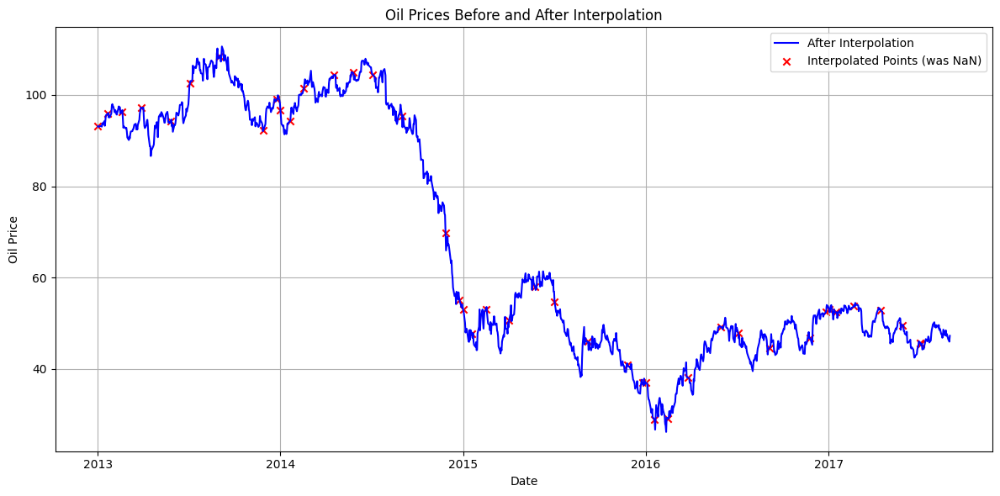

In [17]:
# Create a copy of oil with NaNs with visualization
oil_old = oil.copy()

# Find the points with NaNs
nan_indices = oil_old.loc[oil_old['dcoilwtico'].isnull(), 'date']


# Interpolate missing values
oil['dcoilwtico'] = oil['dcoilwtico'].interpolate(method='linear', limit_direction='both')

# Show result
print("After imputation:", oil.isnull().sum())

# Plot interpolated line (blue)
plt.figure(figsize=(12, 6))
plt.plot(oil['date'], oil['dcoilwtico'], label='After Interpolation', color='blue')

# Plot NaN points as red 'x'
plt.scatter(
    oil_old.loc[oil_old['date'].isin(nan_indices), 'date'],
    oil.loc[oil['date'].isin(nan_indices), 'dcoilwtico'],
    color='red', label='Interpolated Points (was NaN)', marker='x'
)


plt.title('Oil Prices Before and After Interpolation')
plt.xlabel('Date')
plt.ylabel('Oil Price')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

> Ecuador's oil production has sharply fallen in 2015 due to a combination of political crises, anti-oil industry protests, corruption, declining foreign investment, and infrastructure failures. We will discuss the correlation between oil price and sales.

In [18]:
print("Negative value in docilwtico:", (oil['dcoilwtico'] < 0).sum())

Negative value in docilwtico: 0


In [19]:
# Check for duplicates (full identical rows)
print("Duplicate count:")
print(oil.duplicated().sum())

Duplicate count:
0


In [20]:
# Full data range
print("Timeframe:", oil['date'].min(), oil['date'].max())

# Fix timeframe to train to avoid data leakage
oil = oil[oil['date'] <= '2017-08-15']

Timeframe: 2013-01-01 00:00:00 2017-08-31 00:00:00


> Let's see the correlation between the oil price and the sales.

Pearson Correlation between Oil Price and Sales % Change: 0.0218


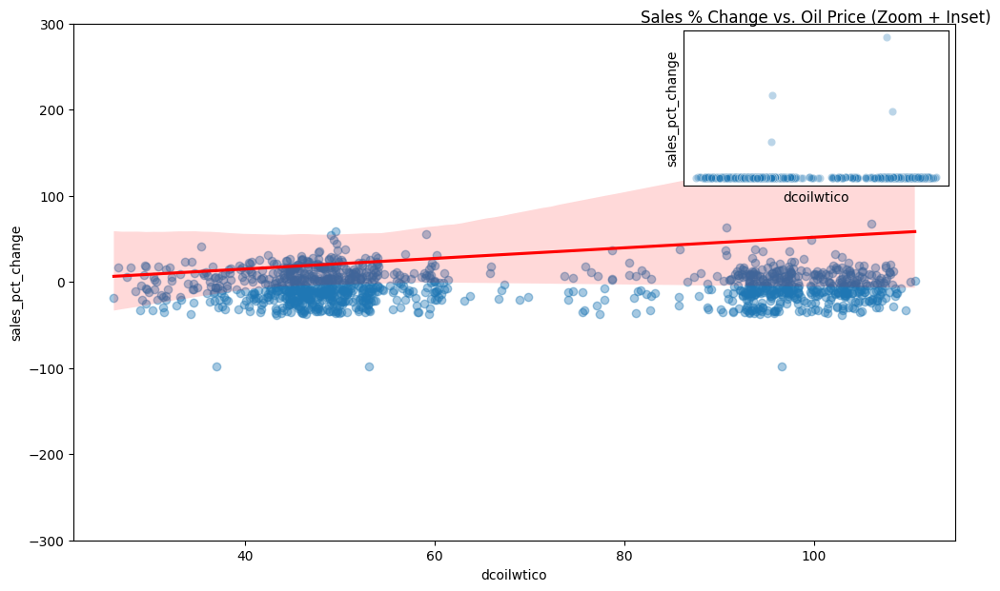

In [21]:
# merge train and oil
oil_train = pd.merge(train,oil,on='date',how='left')

# Group daily sales and mean oil price
daily_grouped = oil_train.groupby('date').agg({
    'sales': 'sum',
    'dcoilwtico': 'mean'
}).reset_index()

# Compute % change in sales (relative change from previous day)
daily_grouped['sales_pct_change'] = daily_grouped['sales'].pct_change() * 100

# Drop first row with NaN in % change
daily_grouped = daily_grouped.dropna(subset=['sales_pct_change'])

# Calculate correlation between oil price and % change in sales
corr_pct = daily_grouped['sales_pct_change'].corr(daily_grouped['dcoilwtico'])
print(f"Pearson Correlation between Oil Price and Sales % Change: {corr_pct:.4f}")

fig, ax = plt.subplots(figsize=(10, 6), constrained_layout=True)
sns.regplot(
    data=daily_grouped,
    x='dcoilwtico',
    y='sales_pct_change',
    scatter_kws={'alpha': 0.4},
    line_kws={'color': 'red'},
    ax=ax
)
ax.set_ylim(-300, 300)  # Focus on the main trend

# Inset for full data
axins = inset_axes(ax, width="30%", height="30%", loc="upper right")
sns.scatterplot(
    data=daily_grouped,
    x='dcoilwtico',
    y='sales_pct_change',
    alpha=0.3,
    ax=axins
)
axins.set_title("Full Range", fontsize=10)
axins.set_xticks([])
axins.set_yticks([])

plt.title("Sales % Change vs. Oil Price (Zoom + Inset)")
plt.show()

Let's try to smooth the trend to see the economic effect: For each day, I average the value over the past N days (including today).
- A 3-day rolling mean on Jan 5 = average of Jan 3, 4, and 5


While visualizing and calculating the correlation between daily oil prices and percentage change in sales, we observed the following:

**Low Correlation (0.0218)**:
The Pearson correlation coefficient between oil price and daily sales % change is very weak, suggesting that oil price does not have a strong or direct influence on daily sales changes.

**Trend Visualization**:
Even with regression and inset visualizations, the relationship remains flat with high variance. Most data points cluster around 0% change, showing no strong reaction to fluctuations in oil price.
While oil prices don't appear to affect overall sales trends significantly, it's important to note that certain product families may still be influenced. There could also be delayed or non-linear effects — for example, price shifts or sudden jumps that impact consumer behavior in more subtle ways.

**Outliers Worth Investigating**:
Clear outliers show fluctuations in sales % change. These could potentially be:

1. Disaster/relief events (e.g., the 2016 earthquake)

2. Holidays with sudden consumer behavior shifts.

3. Promotions in specific stores or families.


Since the correlation isn't high, I want to check if there are any lagged effects, which means the effect kicks in a bit late
Does the oil price from 3 or 7 days ago affect today's sales?

Correlation with 3-day rolling mean: -0.0095


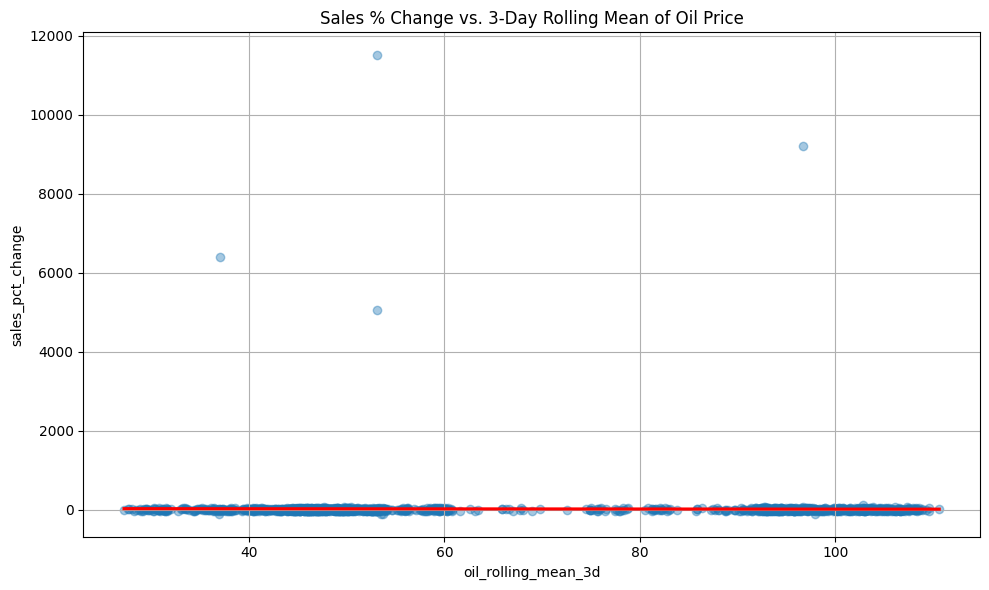

In [22]:
# Compute % change in sales (relative change from previous day)
daily_grouped['sales_pct_change'] = daily_grouped['sales'].pct_change() * 100

# Drop first row with NaN in % change
daily_grouped = daily_grouped.dropna(subset=['sales_pct_change'])

# Rolling features: 3-day mean and std of oil price
daily_grouped['oil_rolling_mean_3d'] = daily_grouped['dcoilwtico'].rolling(window=3, min_periods=1).mean()
daily_grouped['oil_rolling_std_3d'] = daily_grouped['dcoilwtico'].rolling(window=3, min_periods=1).std()

corr_roll_mean = daily_grouped['sales_pct_change'].corr(daily_grouped['oil_rolling_mean_3d'])
print(f"Correlation with 3-day rolling mean: {corr_roll_mean:.4f}")


plt.figure(figsize=(10, 6))
sns.regplot(
    data=daily_grouped,
    x='oil_rolling_mean_3d',
    y='sales_pct_change',
    scatter_kws={'alpha': 0.4},
    line_kws={'color': 'red'}
)
plt.title("Sales % Change vs. 3-Day Rolling Mean of Oil Price")
plt.grid(True)
plt.tight_layout()
plt.show()

Correlation with 3-day lag: -0.0083
Correlation with 7-day lag: 0.0019


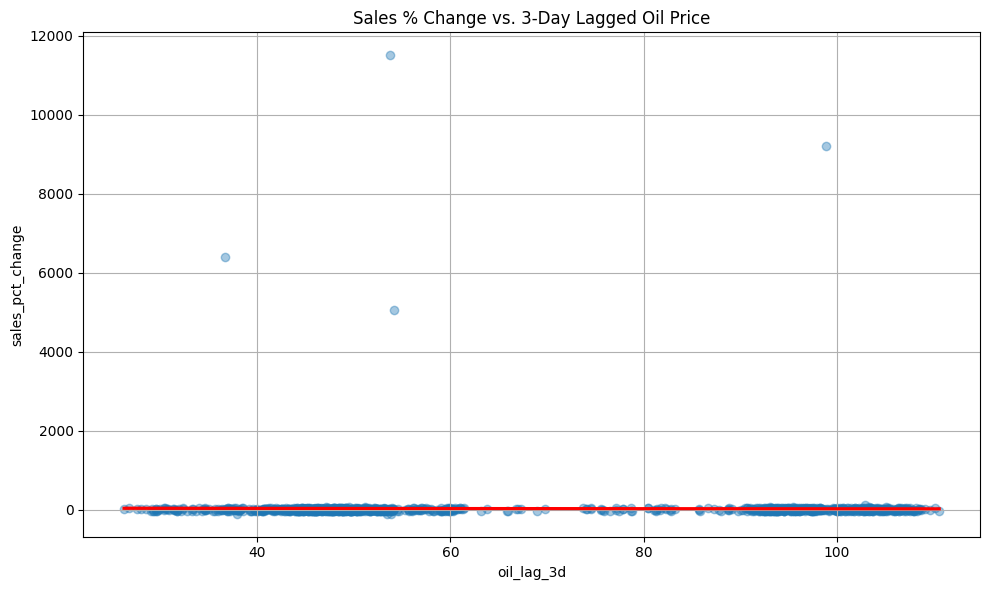

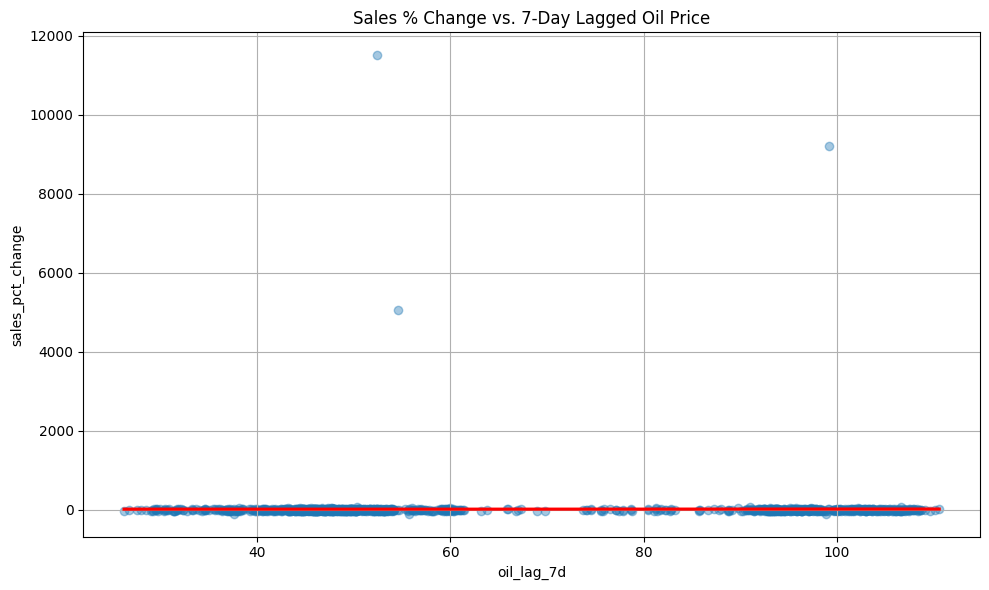

In [23]:
# Lagged features: 3-day and 7-day lag
daily_grouped['oil_lag_3d'] = daily_grouped['dcoilwtico'].shift(3)
daily_grouped['oil_lag_7d'] = daily_grouped['dcoilwtico'].shift(7)

corr_lag_3 = daily_grouped['sales_pct_change'].corr(daily_grouped['oil_lag_3d'])
corr_lag_7 = daily_grouped['sales_pct_change'].corr(daily_grouped['oil_lag_7d'])

print(f"Correlation with 3-day lag: {corr_lag_3:.4f}")
print(f"Correlation with 7-day lag: {corr_lag_7:.4f}")

# 3-day lag plot
plt.figure(figsize=(10, 6))
sns.regplot(
    data=daily_grouped,
    x='oil_lag_3d',
    y='sales_pct_change',
    scatter_kws={'alpha': 0.4},
    line_kws={'color': 'red'}
)
plt.title("Sales % Change vs. 3-Day Lagged Oil Price")
plt.grid(True)
plt.tight_layout()
plt.show()

# 7-day lag plot
plt.figure(figsize=(10, 6))
sns.regplot(
    data=daily_grouped,
    x='oil_lag_7d',
    y='sales_pct_change',
    scatter_kws={'alpha': 0.4},
    line_kws={'color': 'red'}
)
plt.title("Sales % Change vs. 7-Day Lagged Oil Price")
plt.grid(True)
plt.tight_layout()
plt.show()

Despite Ecuador’s economic reliance on oil, our investigation shows that daily oil prices have minimal short-term impact on product sales in this dataset.

**Flat Correlation**

Pearson correlation between daily oil price and sales percentage change was very weak (~0.02).

Even after zooming in and applying regression, the relationship remained visually flat with high variance.

**Rolling Mean (Smoothed Oil Trends)**

Using a 7-day rolling mean for oil prices did not improve the correlation.

This suggests that slow-moving trends in oil don't visibly affect daily consumer sales at the store level.

**Lagged Oil Price Effects**

We tested 3-day and 7-day lagged versions of oil prices to simulate delayed consumer response.

Still, no strong or consistent pattern emerged, implying that oil effects—if any—are indirect or too subtle to capture at the granularity of store-family-date level.

## 1-3. Holiday_events
The holidays dataset contains official holidays, transferred holidays, bridge days, work make-up days, and additional holidays.


- `Transferred holidays` are moved to a different date and should not be treated as holidays on their original date.
- `Bridge days` are extra holidays to extend long weekends, often followed by Work Day make-ups.
- `Additional holidays` are unofficial days added around key celebrations (e.g., Christmas Eve).


In [24]:
holidays.head(10)

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False
5,2012-05-12,Holiday,Local,Puyo,Cantonizacion del Puyo,False
6,2012-06-23,Holiday,Local,Guaranda,Cantonizacion de Guaranda,False
7,2012-06-25,Holiday,Regional,Imbabura,Provincializacion de Imbabura,False
8,2012-06-25,Holiday,Local,Latacunga,Cantonizacion de Latacunga,False
9,2012-06-25,Holiday,Local,Machala,Fundacion de Machala,False


In [25]:
# Check for missing values
print("Missing Values in holidays:")
print(holidays.isnull().sum())

Missing Values in holidays:
date           0
type           0
locale         0
locale_name    0
description    0
transferred    0
dtype: int64


In [26]:
# Check duplicates
print("Is there duplicated rows?")
print(holidays.duplicated().sum())

Is there duplicated rows?
0


In [27]:
# Full data range
print("Timeframe:", holidays['date'].min(), holidays['date'].max())

# Fix timeframe to train to avoid data leakage
holidays = holidays[holidays['date'] <= '2017-08-15']

Timeframe: 2012-03-02 00:00:00 2017-12-26 00:00:00


In [28]:
# Always start from the original unmerged version of train
train_copy = train.copy()

# Filter the holiday types
valid_types = ['Holiday', 'Transfer', 'Bridge', 'Additional']

holidays_filtered = holidays[
    (holidays['type'].isin(valid_types)) &
    ~((holidays['type'] == 'Holiday') & (holidays['transferred'] == True))].copy()

# Create binary flag
holidays_filtered['is_holiday'] = 1

# Keep what we need only
holidays_flag = holidays_filtered[['date', 'is_holiday']]

# Drop existing flag if it already exists (ran before) to avoid merge conflicts
if 'is_holiday' in train_copy.columns:
    train_copy.drop(columns=['is_holiday'], inplace=True)

# Merge into your main data(train)
holiday_train = pd.merge(train_copy, holidays_flag, on='date', how='left')
holiday_train['is_holiday'] = holiday_train['is_holiday'].fillna(0).astype(int)

holiday_train.head(10)

print(holiday_train['is_holiday'].value_counts(normalize=True))

is_holiday
0    0.875733
1    0.124267
Name: proportion, dtype: float64


In [29]:
holiday_corr = holiday_train['sales'].corr(holiday_train['is_holiday'])
print(f"Pearson correlation between Holiday and Sales: {holiday_corr:.4f}")

Pearson correlation between Holiday and Sales: 0.0105


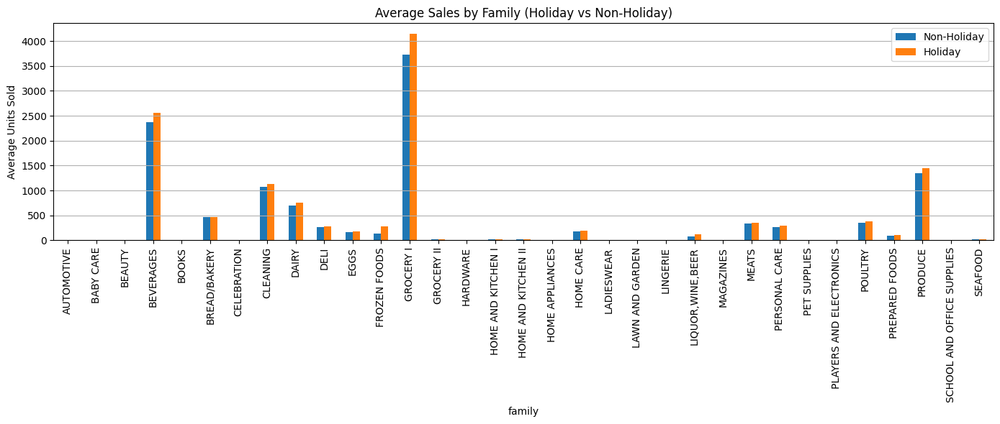

In [30]:
# Compare holiday vs non-holiday means for each product family
family_group = holiday_train.groupby(['family', 'is_holiday'])['sales'].mean().unstack()

# Rename legend name
family_group.columns = ['Non-Holiday', 'Holiday']

# Plot bar chart
family_group.plot(kind='bar', figsize=(14, 6))
plt.title('Average Sales by Family (Holiday vs Non-Holiday)')
plt.ylabel('Average Units Sold')
plt.grid(True, axis='y')
plt.tight_layout()
plt.show()

As we can see from the bar chart above, holidays does seem to impact the sales, but not much though.

## 1-4. Stores
This dataset provides metadata about each of the 54 stores in the Ecuador retail network. While it doesn't change over time, it offers powerful categorical groupings that help explain sales behavior when merged with transactional data. Store characteristics such as type and cluster allow us to explore patterns in sales performance across different store formats and regional similarities.
 
  `store_nbr`: Store identifier (1–54)

  `city`: City where the store is located

  `state`: Ecuadorian state

  `type`: Store format (A to E); likely linked to store size, layout, or inventory variety

  `cluster`: Grouping of stores by unspecified similarity (e.g., demographics or sales behavior)

In [31]:
# Merge "store" and "train"
store_train = pd.merge(train, stores, on='store_nbr', how='left')

print(store_train.head(10))

   id       date  store_nbr        family  sales  onpromotion   city  \
0   0 2013-01-01          1    AUTOMOTIVE    0.0            0  Quito   
1   1 2013-01-01          1     BABY CARE    0.0            0  Quito   
2   2 2013-01-01          1        BEAUTY    0.0            0  Quito   
3   3 2013-01-01          1     BEVERAGES    0.0            0  Quito   
4   4 2013-01-01          1         BOOKS    0.0            0  Quito   
5   5 2013-01-01          1  BREAD/BAKERY    0.0            0  Quito   
6   6 2013-01-01          1   CELEBRATION    0.0            0  Quito   
7   7 2013-01-01          1      CLEANING    0.0            0  Quito   
8   8 2013-01-01          1         DAIRY    0.0            0  Quito   
9   9 2013-01-01          1          DELI    0.0            0  Quito   

       state type  cluster  
0  Pichincha    D       13  
1  Pichincha    D       13  
2  Pichincha    D       13  
3  Pichincha    D       13  
4  Pichincha    D       13  
5  Pichincha    D       13  
6  P

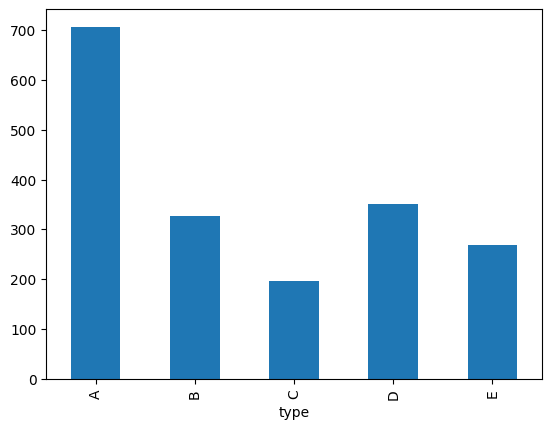

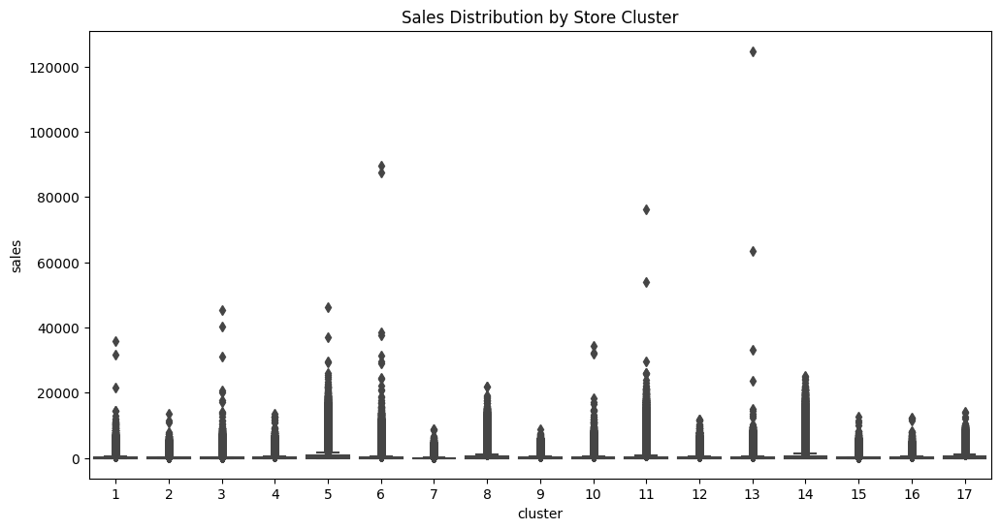

<Axes: xlabel='type', ylabel='family'>

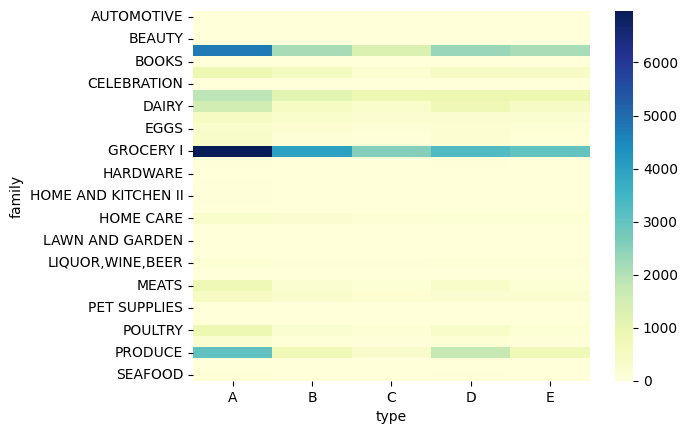

In [32]:
store_train.groupby('type')['sales'].mean().plot(kind='bar')


plt.figure(figsize=(12, 6))
sns.boxplot(data=store_train, x='cluster', y='sales')
plt.title("Sales Distribution by Store Cluster")
plt.show()

pivot = store_train.pivot_table(index='family', columns='type', values='sales', aggfunc='mean')
sns.heatmap(pivot, cmap='YlGnBu')


We can say that:

1. **Type A stores dominate**

Any trends found in Type A stores will have a strong impact on the overall trend, simply due to volume. Also, normalization could be needed to mitigate the effect, or I will use a tree-based model since it's less vulnerable to dispersion.
   
2. **Sales variance across clusters is significant**
Clusters 5, 11, 14, and 17 show rare but strong spikes in sales.
This could be due to:

- Location (e.g., near city centers or event venues)

- Unique product offerings

- Special promotions

Investigating these high-outlier clusters could reveal useful store segmentation features or interactions.

3. **Product demand is very dependent on store type**

 Type A stores seem to be more "all-round" or high-traffic. Some store types might not carry certain product families at all (e.g., HARDWARE, MEATS).

4. **Many products have low or no sales**
The heatmap reveals several families with consistently low activity, possibly:

- Niche products

- Seasonal inventory

- Stocking differences

These families could be candidates for **zero-forecasting models** or excluded from certain predictive scopes to reduce noise.



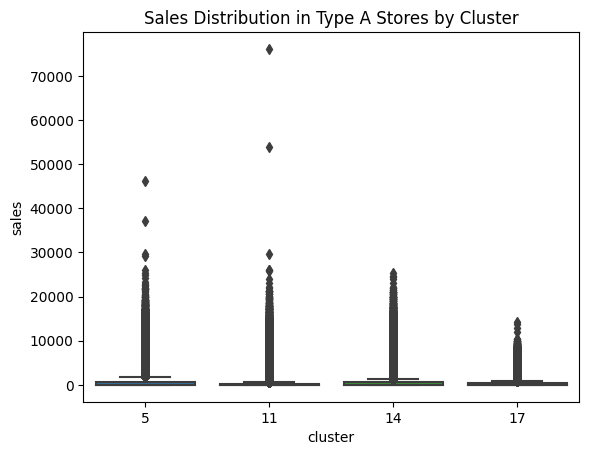

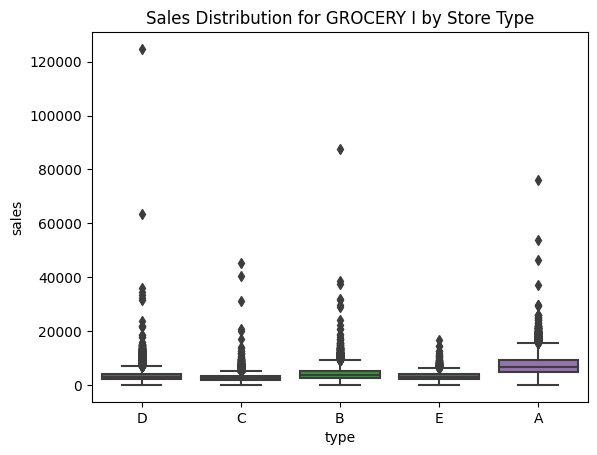

In [33]:
## Highlight why Type A and GROCERY I may dominate
# Filter for GROCERY I and Type A
type_a = store_train[store_train['type'] == 'A']
grocery_i = store_train[store_train['family'] == 'GROCERY I']

# Compare by cluster
sns.boxplot(data=type_a, x='cluster', y='sales')
plt.title("Sales Distribution in Type A Stores by Cluster")
plt.show()

sns.boxplot(data=grocery_i, x='type', y='sales')
plt.title("Sales Distribution for GROCERY I by Store Type")
plt.show()


From the first boxplot, we can assume **type and cluster** might play an important role.

- Even within Type A, different clusters (like 5, 11, 14, 17) have noticeably different sales behaviors — suggesting cluster adds nuance beyond just store type.

- For the GROCERY I family, sales are highest in Type A stores — both in terms of median and outliers  confirming that certain product families have strong store-type affinity.

- These plots reinforce the idea that sales prediction is not uniform across stores — interactions between product family, store type, and cluster matter.

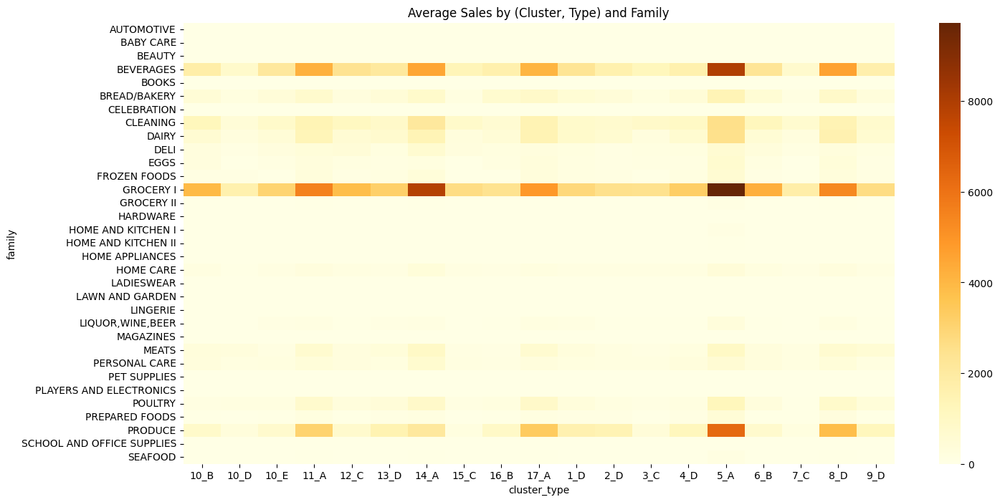

In [34]:
# Heatmap grouped by cluster and type
store_train['cluster_type'] = store_train['cluster'].astype(str) + "_" + store_train['type']
pivot = store_train.pivot_table(index='family', columns='cluster_type', values='sales', aggfunc='mean')
plt.figure(figsize=(16, 8))
sns.heatmap(pivot, cmap='YlOrBr')
plt.title("Average Sales by (Cluster, Type) and Family")
plt.show()


Certain combinations clearly outperform others, e.g.: 

- GROCERY I in 5_A (Cluster 5, Type A)

- PREPARED FOODS in 8_B

This shows that (cluster, type) grouping captures store-specific strengths in product categories — something that simple one-hot type or cluster features may miss.

Suggests a strong case for creating a **combined categorical feature** like type_cluster or encoding this interaction explicitly in models.



## 1-5. Transaction
This dataset records the number of transactions made each day at each store (store-level granularity, not by product).
Transactions can be interpreted as a proxy for store traffic or footfall — the higher the number, the more people likely visited and made purchases.

- If sales are high and transactions are low → customers may be purchasing in bulk

- If both sales and transactions are high → could suggest high demand, strong foot traffic, or promotions

- If sales stay flat while transactions increase, it may hint at more visits with smaller purchases (low-value basket)

In [35]:
print(transactions.head(10))

        date  store_nbr  transactions
0 2013-01-01         25           770
1 2013-01-02          1          2111
2 2013-01-02          2          2358
3 2013-01-02          3          3487
4 2013-01-02          4          1922
5 2013-01-02          5          1903
6 2013-01-02          6          2143
7 2013-01-02          7          1874
8 2013-01-02          8          3250
9 2013-01-02          9          2940


In [36]:
# Total missing values
print(transactions.isnull().sum())

date            0
store_nbr       0
transactions    0
dtype: int64


In [37]:
# Check for duplicates
print("Duplicate count:",transactions.duplicated().sum())

Duplicate count: 0


In [38]:
# Check for negative transaction values
print("Negative values:", (transactions['transactions'] < 0).sum())

# Check for non-integer (decimal) values
print("Decimal values:", (transactions['transactions'] % 1 != 0).sum())

Negative values: 0
Decimal values: 0


In [39]:
# Full date coverage
print("Timeframe:", transactions['date'].min(), transactions['date'].max())

Timeframe: 2013-01-01 00:00:00 2017-08-15 00:00:00


Correlation between sales and transactions: 0.2331


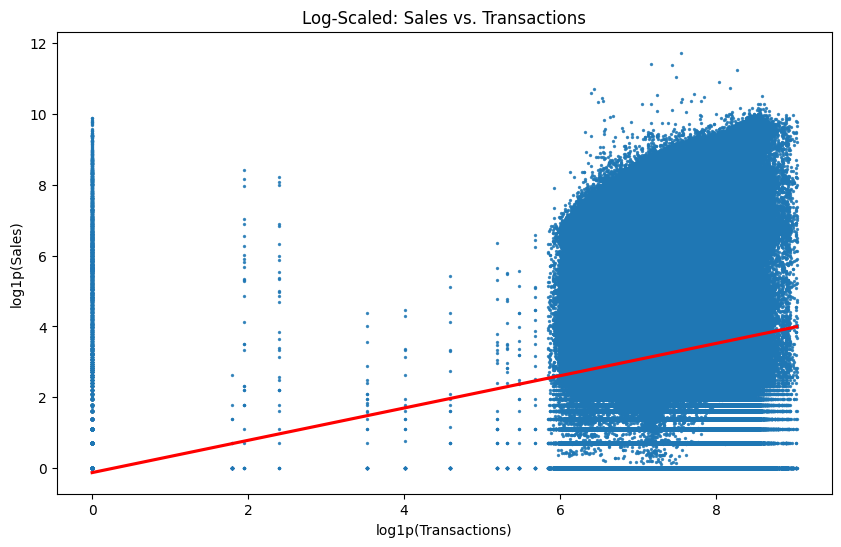

In [40]:
# Merge train with transactions on store and date
transa_train = pd.merge(train, transactions, on=['store_nbr', 'date'], how='left')
# Fill rows with no transaction with 0
transa_train['transactions'] = transa_train['transactions'].fillna(0)
transa_train.head(10)
# Pearson correlation
correlation = transa_train['sales'].corr(transa_train['transactions'])
print(f"Correlation between sales and transactions: {correlation:.4f}")


# We use log-scaled because most data is in the bottom
plt.figure(figsize=(10, 6))
sns.regplot(
    x=np.log1p(transa_train['transactions']),
    y=np.log1p(transa_train['sales']),
    scatter_kws={'s': 2},
    line_kws={'color': 'red'}
)
plt.title('Log-Scaled: Sales vs. Transactions')
plt.xlabel('log1p(Transactions)')
plt.ylabel('log1p(Sales)')
plt.show()

The **Pearson correlation is 0.2331**, indicating a **weak to moderate positive** linear relationship.

This means more transactions generally lead to more sales — which makes intuitive sense — but the relationship is not perfectly linear.

There’s a dense cluster at the bottom right, meaning:

Most records have a high number of transactions and low-to-mid sales.

Possibly frequent, small purchases dominate the sales patterns.

A small cloud of outliers at the top left (high sales, low transactions) may represent:

- Bulk buying behavior

- Certain product families like MEATS, SEAFOOD, or DAIRY

- Holidays or wholesale events

In [41]:
# Merge transactions into train 
train = pd.merge(train, transactions, on=['store_nbr', 'date'], how='left')

# Fill missing transactions with 0
train['transactions'] = train['transactions'].fillna(0)

# Add log-transformed transactions (log1p for safe 0-handling)
train['log_transactions'] = np.log1p(train['transactions'])


## 1-6. Key actions before advanced analysis
1. Create Interaction Features
2. Per-Customer Behavior Features
3. Time-Aware Features
4. Handle Low-Activity Product Families
5. Decide How to Model Zeros 
6. Investigate Outliers
7. Merge the datasets
8. Check for Data Leakage

### 1. Create Interaction Features
EDA showed strong interactions (e.g., store_type × family, cluster × type), and models can benefit a lot from this.

In [42]:
train['type_cluster'] = stores['type'] + '_' + stores['cluster'].astype(str)
train['store_family'] = train['store_nbr'].astype(str) + '_' + train['family']

### 2. Engineer Per-Customer Behavior Feature
Type A stores dominate in both quantity and sales volume.
We create `sales_per_transaction`, it addresses store size bias indirectly:

How much do people buy per visit, regardless of how many visitors the store gets?

In [43]:
 train['sales_per_transaction'] = train['sales'] / (transactions['transactions'] + 1e-5) #avoid system crashing if both sales and transaction are 0

### 3. Date-aware Features
Mostly for patterns, trends for different time period

In [44]:
# Ensure datetime
train['date'] = pd.to_datetime(train['date'])

# Day of week (0=Monday, 6=Sunday)
train['day_of_week'] = train['date'].dt.dayofweek

# Month (1-12)
train['month'] = train['date'].dt.month

# Year
train['year'] = train['date'].dt.year

# Is weekend (1 if Saturday or Sunday)
train['is_weekend'] = train['day_of_week'].isin([5, 6]).astype(int)


# Week of year (for long-term trends)
train['weekofyear'] = train['date'].dt.isocalendar().week.astype(int)

# We also merge the 'is_holiday' used previously into train dataset
train = pd.merge(train, holidays_flag, on='date', how='left')
train['is_holiday'] = train['is_holiday'].fillna(0).astype(int)


### 4. Low-Activity Product Families
Labeling low-activity product families can give model a shortcut signal: “Don’t expect much from this combo”.

-> `If store_family= HARDWARE_18` AND `is_rare_family = 1` → model may learn to predict 0

In [45]:
#  Identify low-activity families
family_sales = train.groupby('family')['sales'].mean()
rare_families = family_sales[family_sales < 1.0].index

# Add binary flag to your main data
train['is_rare_family'] = train['family'].isin(rare_families).astype(int)

### 5. Decide How to Model Zeros
We notice a lot of zero sales in our dataset, so predicting them would be troublesome.

My thought is to use a single tree-based model, such as **log1p + LightGBM**, to reduce the effect of large outliers, and it treats zero sales gently.

If neccessary(not overkill), two-stage model would also be a good experiment.

Stage 1: Classifier for sales > 0

Stage 2: Regressor for non-zero sales

### 6. Investigate Outliers
We're already committed to going with tree-based models for our prediction, outlier handling becomes more about **understanding the data than about preprocessing for algorithm stability**!!

Tree-based models (LightGBM/XGBoost):

- It splits based on feature thresholds, not mean/variance

- Aren't affected by feature scale

- Can isolate outliers in specific branches (e.g., "if sales > 10,000 → go here")


But we still do it because:

- We can explain weird patterns in plots or feature importance

- Understand risk cases for RMSE (which penalizes large mistakes!!)

- Identify specific dates/stores/families that still might deserve special modeling

#### 6-1. Plot Sales Distribution (Raw + Log1p)
This helps you visually confirm if you have a long tail and many zeros.

In [46]:

# Raw sales
fig1 = px.histogram(train, x='sales', nbins=100, title='Raw Sales Distribution')
fig1.update_layout(bargap=0.1)
fig1.show()

# Log1p-transformed sales
train['log_sales'] = np.log1p(train['sales'])  # create new column
fig2 = px.histogram(train, x='log_sales', nbins=100, title='Log1p Sales Distribution')
fig2.update_layout(bargap=0.1)
fig2.show()

- Raw sales are extremely right-skewed, with most records having low values and only a few extreme highs (e.g., above 100,000 units).

- Log1p sales transformed sales normalize the scale, revealing a smoother distribution.

#### 6-2. Add `is_outlier` Flag 
 Use this feature in modeling later or maybe for filtered plotting.

In [47]:
 # Flag top 0.1% of sales as outliers
threshold = train['sales'].quantile(0.999)
train['is_outlier'] = (train['sales'] > threshold).astype(int)

# Preview the ratio
train['is_outlier'].value_counts(normalize=True)

is_outlier
0    0.999
1    0.001
Name: proportion, dtype: float64

#### 6-3. Investigate Spikes Over Time (Total Sales by Date/store/family/store_family)
Inspect spikes in different categories.

In [48]:
# Total sales (date)
daily_sales = train.groupby('date')['sales'].sum().reset_index()

fig3 = px.line(daily_sales, x='date', y='sales', title='Total Sales Over Time (Spikes Detection)')
fig3.update_traces(line=dict(color='royalblue'))
fig3.show()


Yay, we see that Total daily sales show clear periodic spikes, likely tied to:

- Holidays (especially Christmas in December, Machala Day in June, Santo Domingo de los Colorados Canton Anniversary in July)

- Payday effects (end/start of months)

- Promotions or transfer holidays (if present in the holidays data)

This strongly supports using time-aware features 

In [49]:
# Total sales (store)
daily_sales = train.groupby('store_nbr')['sales'].sum().reset_index()

fig3 = px.line(daily_sales, x='store_nbr', y='sales', title='Total Sales Over Time (Spikes Detection)')
fig3.update_traces(line=dict(color='royalblue'))
fig3.show()


In [50]:
# Total sales (family)
daily_sales = train.groupby('family')['sales'].sum().reset_index()

fig3 = px.line(daily_sales, x='family', y='sales', title='Total Sales Over Time (Spikes Detection)')
fig3.update_traces(line=dict(color='royalblue'))
fig3.show()


In [51]:
# Total sales (store_family)
daily_sales = train.groupby('store_family')['sales'].sum().reset_index()

fig3 = px.line(daily_sales, x='store_family', y='sales', title='Total Sales Over Time (Spikes Detection)')
fig3.update_traces(line=dict(color='royalblue'))
fig3.show()


- Some stores show clearly higher total sales (store 47–50 range), potentially high-traffic or flagship stores.

- Product families like GROCERY I and BEVERAGES dominate overall sales — they deserve feature attention (e.g., one-hot, interactions).

- store-family pairs show compound spikes — some may be seasonal or linked to regional promotions.

These can be used for potential segmentation or modeling special conditions for those pairs.

### 7. Check our final train datasets

In [52]:
train.head(10)
# include log_transaction and transaction

,id,date,store_nbr,family,sales,onpromotion,transactions,log_transactions,type_cluster,store_family,sales_per_transaction,day_of_week,month,year,is_weekend,weekofyear,is_holiday,is_rare_family,log_sales,is_outlier
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,0.0,0.0,D_13,1_AUTOMOTIVE,0.0,1,1,2013,0,1,1,0,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0,0.0,0.0,D_13,1_BABY CARE,0.0,1,1,2013,0,1,1,1,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0,0.0,0.0,D_8,1_BEAUTY,0.0,1,1,2013,0,1,1,0,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0,0.0,0.0,D_9,1_BEVERAGES,0.0,1,1,2013,0,1,1,0,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0,0.0,0.0,D_4,1_BOOKS,0.0,1,1,2013,0,1,1,1,0.0,0
5,5,2013-01-01,1,BREAD/BAKERY,0.0,0,0.0,0.0,D_13,1_BREAD/BAKERY,0.0,1,1,2013,0,1,1,0,0.0,0
6,6,2013-01-01,1,CELEBRATION,0.0,0,0.0,0.0,D_8,1_CELEBRATION,0.0,1,1,2013,0,1,1,0,0.0,0
7,7,2013-01-01,1,CLEANING,0.0,0,0.0,0.0,D_8,1_CLEANING,0.0,1,1,2013,0,1,1,0,0.0,0
8,8,2013-01-01,1,DAIRY,0.0,0,0.0,0.0,B_6,1_DAIRY,0.0,1,1,2013,0,1,1,0,0.0,0
9,9,2013-01-01,1,DELI,0.0,0,0.0,0.0,C_15,1_DELI,0.0,1,1,2013,0,1,1,0,0.0,0


### 8. Data leakage
Data leakage happens when your model has access to information during training that it wouldn't have at prediction time.

Check the train/validation/test split is time-based (not random): Good

Lag features only use previous dates: Good

Avoid aggregating across future dates: Good

No merged dataset contains future insight unless it's based on the same date or before: caution, holiday and oil datasets have different timeframes

## 2. Further analyze

## What we learned to help modeling

## 3. Prediction Model

## Reference
https://oilprice.com/Energy/Crude-Oil/The-Fall-Of-Ecuadors-Oil-Empire.html